In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from keras.preprocessing.image import load_img, array_to_img
from keras.models import Sequential, Model
from keras import layers
from keras.losses import BinaryCrossentropy
from keras.optimizers import Adam
import random

warnings.filterwarnings('ignore')

In [3]:
IMG_DIR1='/kaggle/input/animefacedataset/images'
IMG_DIR2='/kaggle/input/anime-faces/data'

#Copying full path of images to a list
image_paths=[]
for img_name in os.listdir(IMG_DIR1):
    image_paths.append(IMG_DIR1 +'/'+ img_name)
for img_name in os.listdir(IMG_DIR2):
    image_paths.append(IMG_DIR2 +'/'+ img_name)

In [4]:
len(image_paths)

85117

In [5]:
random.shuffle(image_paths)

In [6]:
image_paths[:5]

['/kaggle/input/anime-faces/data/861.png',
 '/kaggle/input/animefacedataset/images/51849_2015.jpg',
 '/kaggle/input/animefacedataset/images/1586_2001.jpg',
 '/kaggle/input/anime-faces/data/15276.png',
 '/kaggle/input/animefacedataset/images/52914_2016.jpg']

## Dataset Visualization

In [12]:
#remove:'/kaggle/input/anime-faces/data/7071.png',''/kaggle/input/anime-faces/data/data''
image_paths.remove('/kaggle/input/anime-faces/data/7071.png')
image_paths.remove('/kaggle/input/anime-faces/data/data')

ValueError: num must be an integer with 1 <= num <= 144, not 145

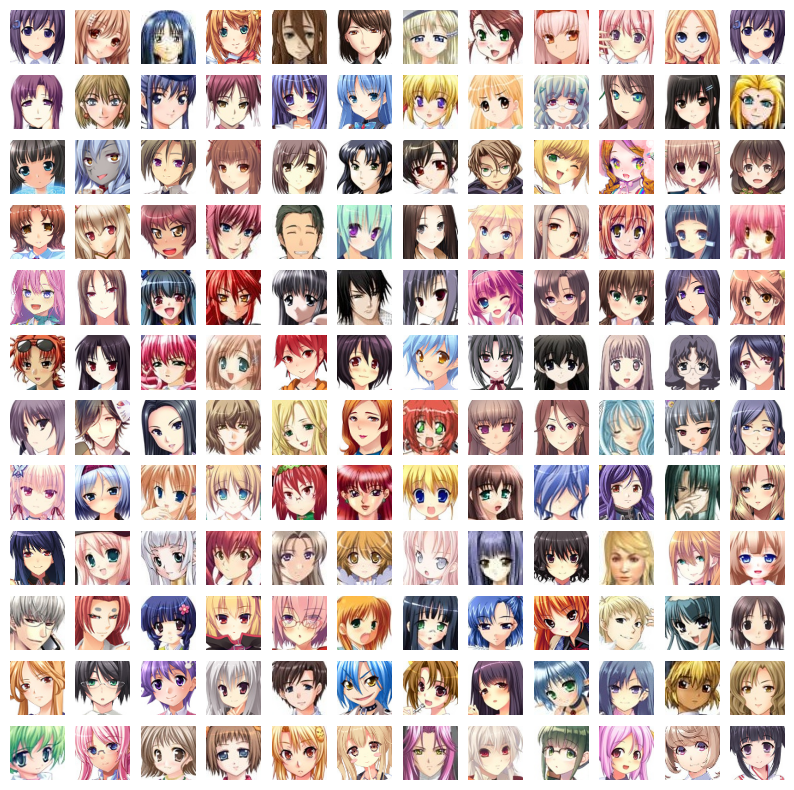

In [8]:
plt.figure(figsize=(10,10))
imgs=image_paths[:121]
index=1

for i in image_paths:
    plt.subplot(12,12,index)
    img=load_img(i)
    img=np.array(img)
    plt.imshow(img)
    plt.axis('off')
    index+=1


## Image reshaping and converting to array

In [13]:
#Load the images in PIL format ,resize the image and coinverting them to numpy array

target_size = (64, 64)

X_train = []

for p in tqdm(image_paths):
    img = load_img(p)
    img = img.resize(target_size)
    X_train.append(np.array(img))

X_train = np.array(X_train)

  0%|          | 0/85115 [00:00<?, ?it/s]

In [14]:
np.save('X_train.npy', X_train)

In [15]:
# X_train = np.load('/kaggle/input/x-train/X_train.npy')

In [16]:
X_train[0].shape

(64, 64, 3)

In [17]:
X_train=X_train.reshape(X_train.shape[0],64,64,3).astype('float')

In [18]:
X_train.shape

(85115, 64, 64, 3)

In [19]:
#Normalizing the pixel values
X_train=(X_train-127.5)/127.5

In [20]:
X_train[0]

array([[[ 0.97647059,  1.        ,  0.96862745],
        [ 0.4745098 ,  0.41176471,  0.51372549],
        [ 0.31764706,  0.14509804,  0.43529412],
        ...,
        [-0.23921569, -0.41176471, -0.18431373],
        [-0.04313725, -0.21568627,  0.10588235],
        [-0.12156863, -0.25490196, -0.01176471]],

       [[ 1.        ,  1.        ,  1.        ],
        [ 0.08235294, -0.01176471,  0.16862745],
        [ 0.41960784,  0.23137255,  0.54509804],
        ...,
        [-0.25490196, -0.38823529, -0.21568627],
        [-0.14509804, -0.3254902 , -0.00392157],
        [-0.12156863, -0.2627451 ,  0.00392157]],

       [[ 0.80392157,  0.78039216,  0.81960784],
        [ 0.27058824,  0.14509804,  0.40392157],
        [ 0.22352941,  0.01176471,  0.35686275],
        ...,
        [-0.19215686, -0.30196078, -0.08235294],
        [-0.27843137, -0.45098039, -0.18431373],
        [ 0.03529412, -0.1372549 ,  0.16078431]],

       ...,

       [[ 0.58431373,  0.56078431,  0.69411765],
        [ 0

In [21]:
LATENT_DIM=100
WEIGHT_INIT=keras.initializers.RandomNormal(mean=0,stddev=0.02)
CHANNELS=3

## Generator Model Creation

In [22]:
model = Sequential(name='generator')

# 1d random noise
model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
model.add(layers.ReLU())

# convert 1d to 3d
model.add(layers.Reshape((8, 8, 512)))

# upsample to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.ReLU())

# upsample to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.ReLU())

# upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 32768)          │     3,309,568 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu (ReLU)                    │ (None, 32768)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 8, 8, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose                │ (None, 16, 16, 256)    │     2,097,408 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_1 (ReLU)                  │ (None, 16, 16, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_1              │ (None, 32, 32, 128)    │       524,416 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_2 (ReLU)                  │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 64, 64, 64)     │       131,136 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_3 (ReLU)                  │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 64, 64, 3)      │         3,075 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,065,603 (23.14 MB)

 Trainable params: 6,065,603 (23.14 MB)

 Non-trainable params: 0 (0.00 B)

## Discriminator Model Creation

In [23]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_1 (Conv2D)               │ (None, 32, 32, 64)     │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 32, 32, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 16, 16, 128)    │       131,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 8, 8, 128)      │       262,272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 8, 8, 128)      │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │         8,193 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 406,081 (1.55 MB)

 Trainable params: 405,441 (1.55 MB)

 Non-trainable params: 640 (2.50 KB)

## Creating DCGAN (Deep Convolutional GAN)

In [24]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')
        
    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]
    
    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn
        
    def train_step(self, real_images):
        batch_size = tf.shape(real_images)[0]
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))
        
        #Train Discriminator
        #fake - 0 , real - 1 (images)
        with tf.GradientTape() as tape:
            pred_real = self.discriminator(real_images, training=True)
            real_labels = tf.ones((batch_size, 1))
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)
            
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)
            
            d_loss = (d_loss_real + d_loss_fake) / 2
            
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))
        
        #Training Generator
        labels = tf.ones((batch_size, 1))
        with tf.GradientTape() as tape:
            fake_images = self.generator(random_noise, training=True)
            pred_fake = self.discriminator(fake_images, training=True)
            g_loss = self.loss_fn(labels, pred_fake)
            
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))
        
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)
        
        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

## Monitoring during the training 

In [25]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        self.noise = tf.random.normal(shape=(25, latent_dim))

    def on_epoch_end(self, epoch, logs=None):
        g_img = self.model.generator(self.noise)
        g_img = (g_img * 127.5) + 127.5
        g_img=g_img.numpy()
        
        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()
        if epoch % 10==0:
            self.model.generator.save('generator_epoch_{:03d}.h5'.format(epoch))
            self.model.discriminator.save('discriminator_epoch_{:03d}.h5'.format(epoch))
        
    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')
        self.model.discriminator.save('discriminator.h5')

## Initialize the model and compile it and start training

In [26]:
dcgan=DCGAN(generator=generator,discriminator=discriminator,latent_dim=LATENT_DIM)

#Learning rates of both models
D_LR=0.0001
G_LR=0.0003
g_opt=Adam(learning_rate=G_LR, beta_1=0.5)
d_opt=Adam(learning_rate=D_LR, beta_1=0.5)
dcgan.compile(g_optimizer=g_opt, d_optimizer=d_opt, loss_fn=BinaryCrossentropy())

Epoch 1/50
   5/2660 ━━━━━━━━━━━━━━━━━━━━ 1:24 32ms/step - d_loss: 1.4350 - g_loss: 0.5701  

I0000 00:00:1715892093.761488      87 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.
W0000 00:00:1715892093.787808      87 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


2660/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - d_loss: 0.7743 - g_loss: 2.1984

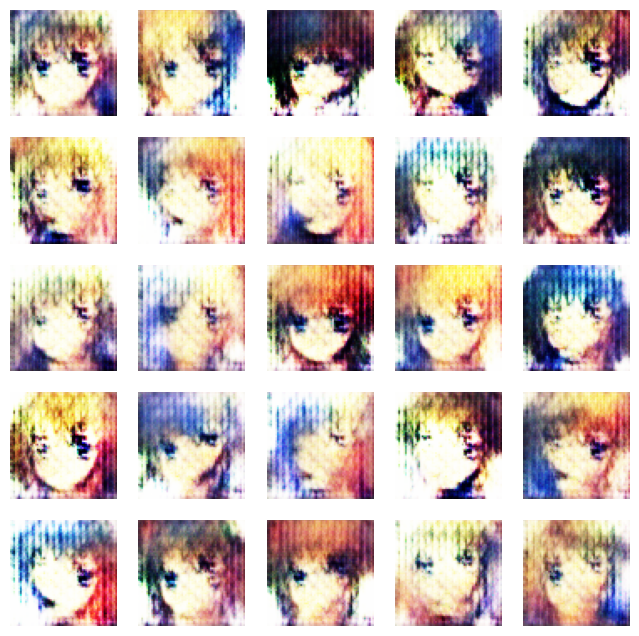

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 112s 35ms/step - d_loss: 0.7743 - g_loss: 2.1983
Epoch 2/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6670 - g_loss: 1.3638

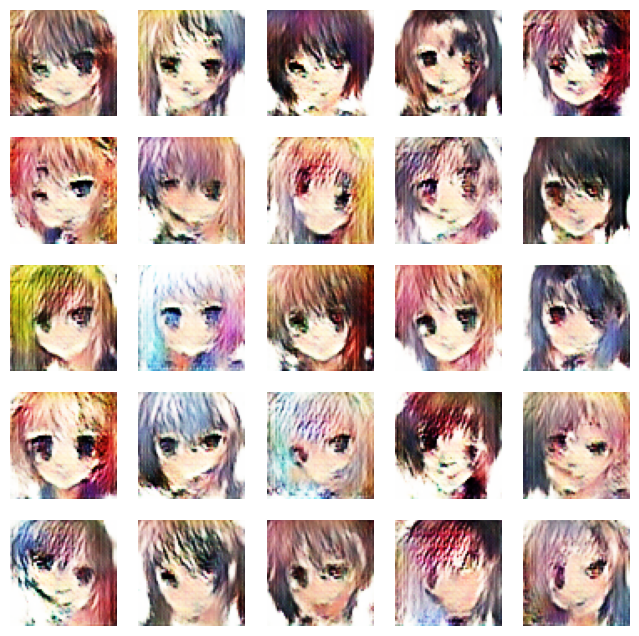

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.6670 - g_loss: 1.3638
Epoch 3/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.6974 - g_loss: 0.9705

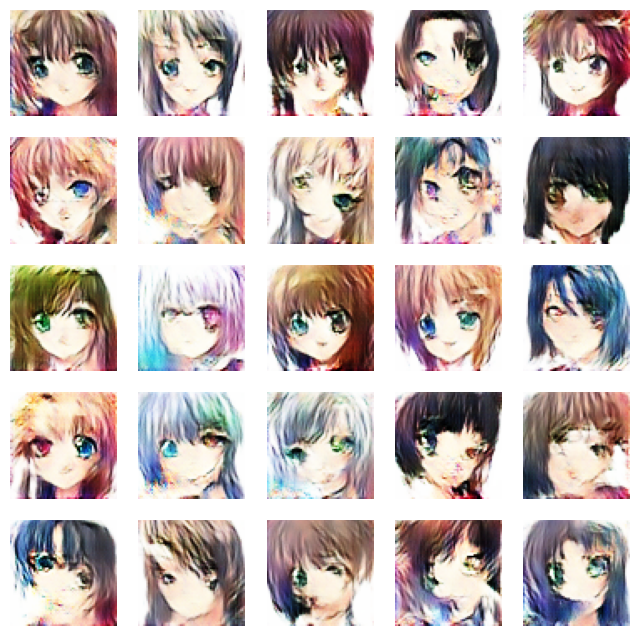

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.6974 - g_loss: 0.9705
Epoch 4/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.7103 - g_loss: 0.8082

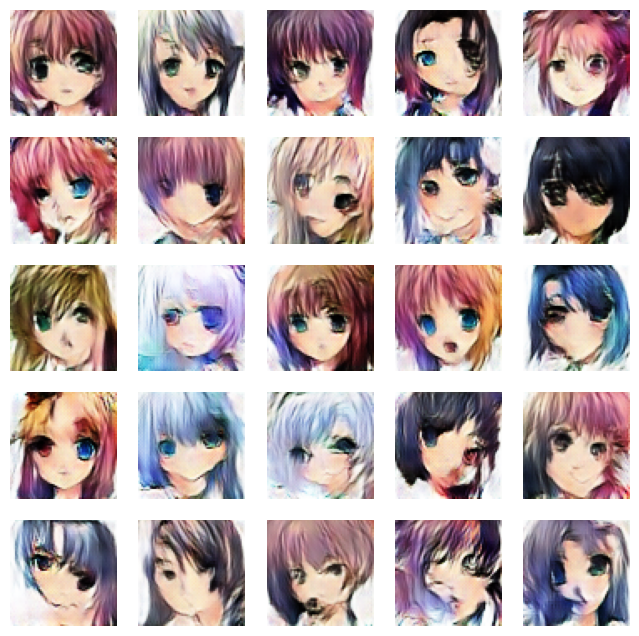

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.7103 - g_loss: 0.8082
Epoch 5/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.7058 - g_loss: 0.7664

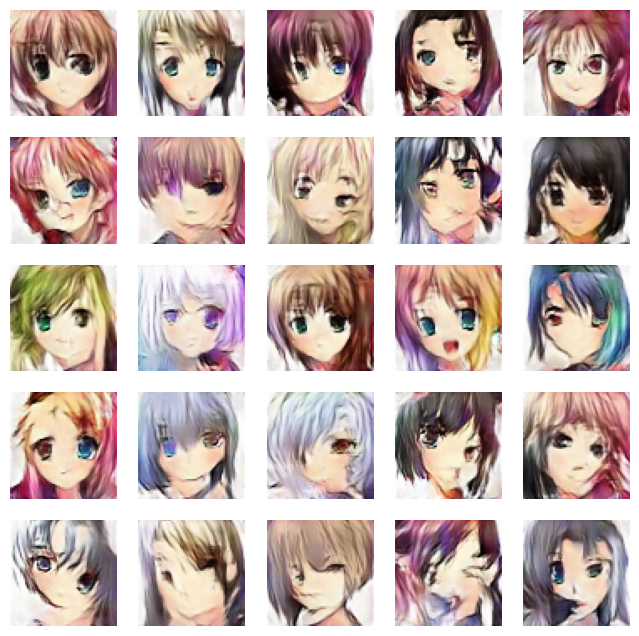

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.7058 - g_loss: 0.7664
Epoch 6/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.6982 - g_loss: 0.7630

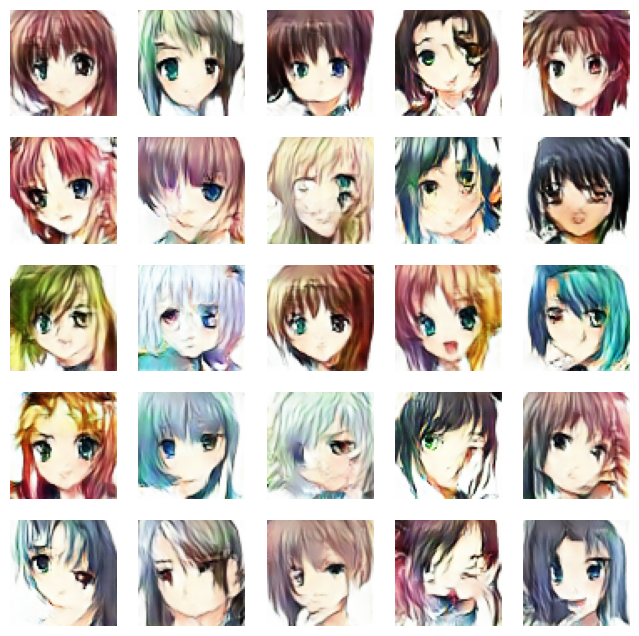

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.6982 - g_loss: 0.7630
Epoch 7/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.6902 - g_loss: 0.7744

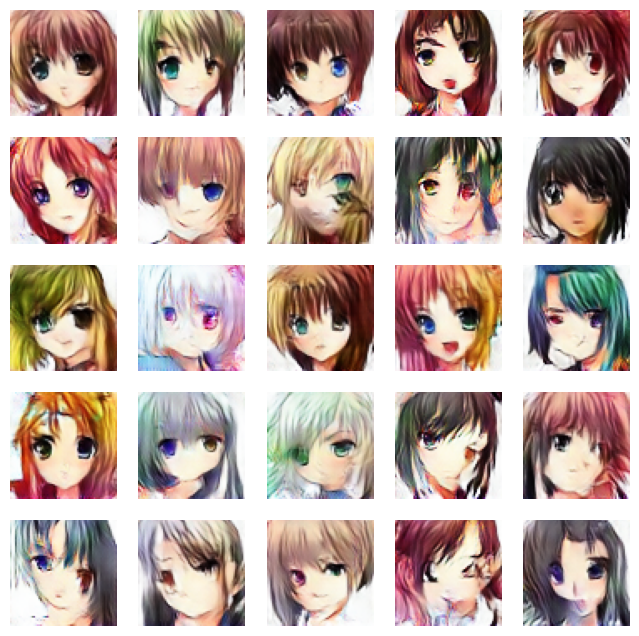

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.6902 - g_loss: 0.7744
Epoch 8/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6853 - g_loss: 0.7775

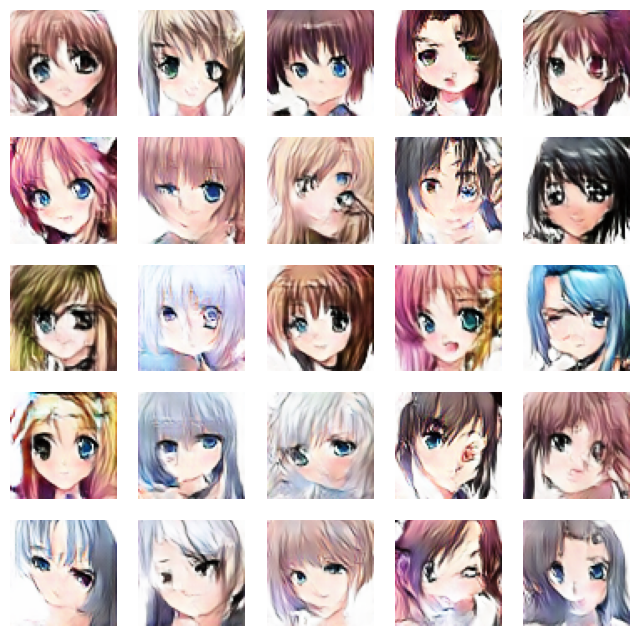

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.6853 - g_loss: 0.7775
Epoch 9/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6817 - g_loss: 0.7945

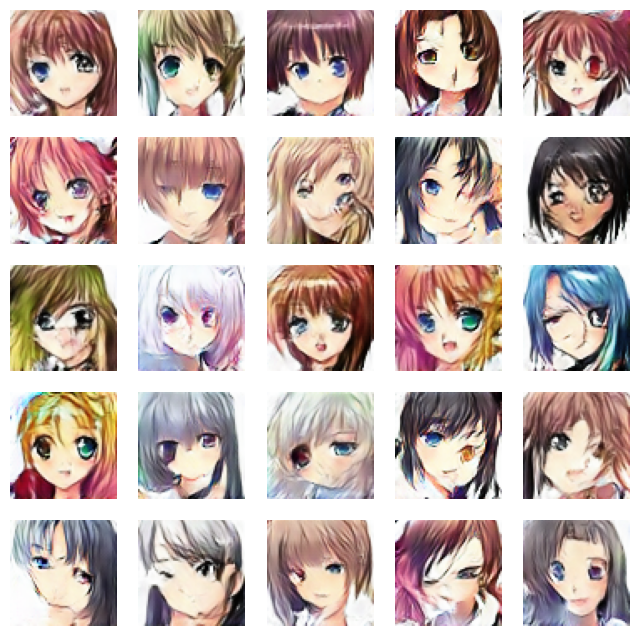

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 79s 30ms/step - d_loss: 0.6817 - g_loss: 0.7945
Epoch 10/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6765 - g_loss: 0.8055

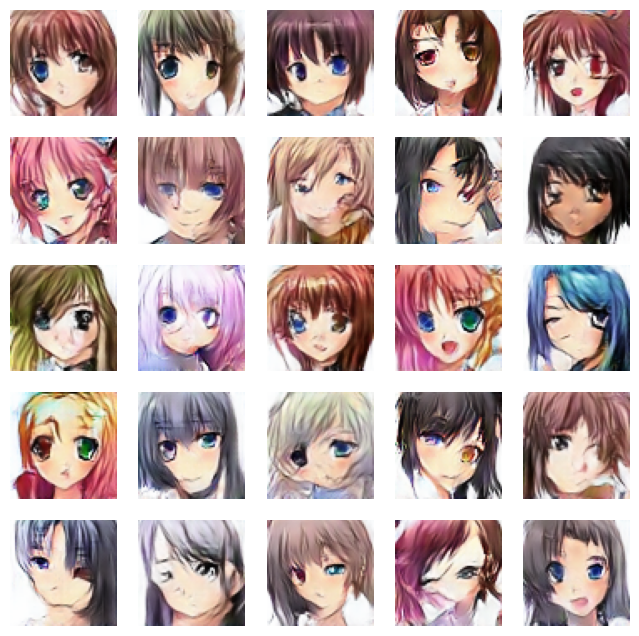

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.6765 - g_loss: 0.8055
Epoch 11/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6716 - g_loss: 0.8266

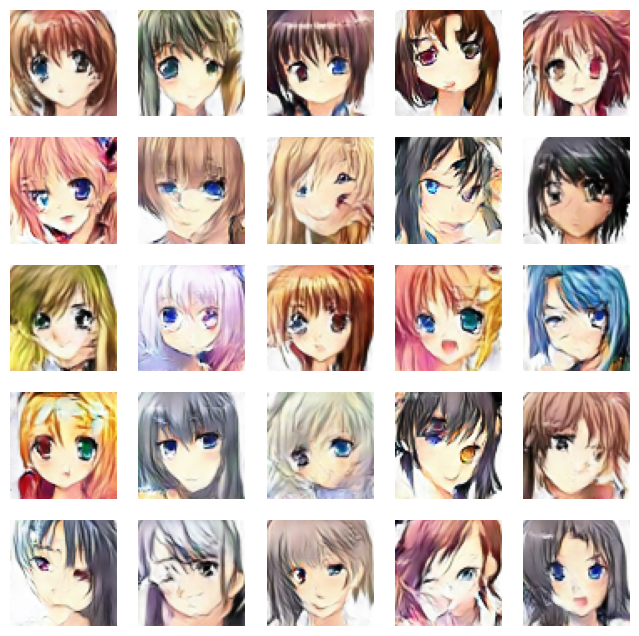

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.6716 - g_loss: 0.8266
Epoch 12/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6651 - g_loss: 0.8449

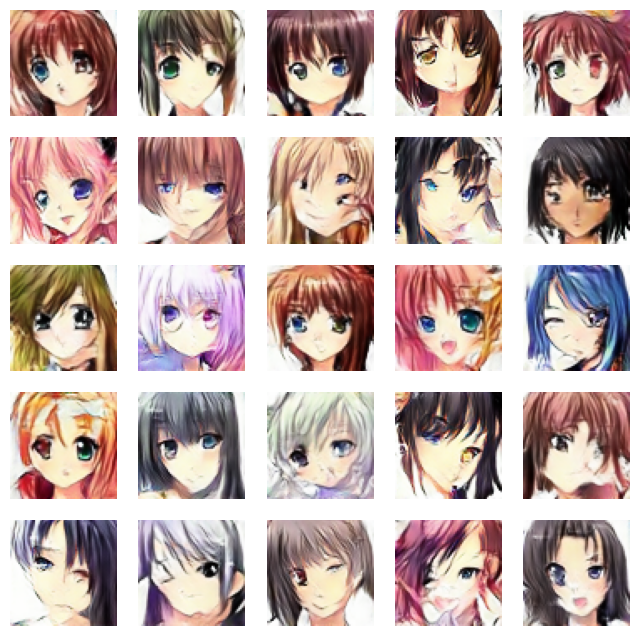

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.6651 - g_loss: 0.8449
Epoch 13/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6576 - g_loss: 0.8674

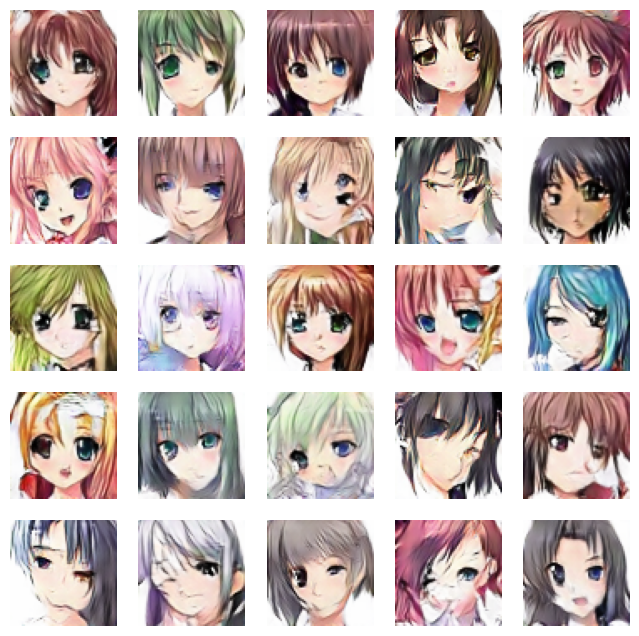

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 78s 29ms/step - d_loss: 0.6576 - g_loss: 0.8674
Epoch 14/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6523 - g_loss: 0.8872

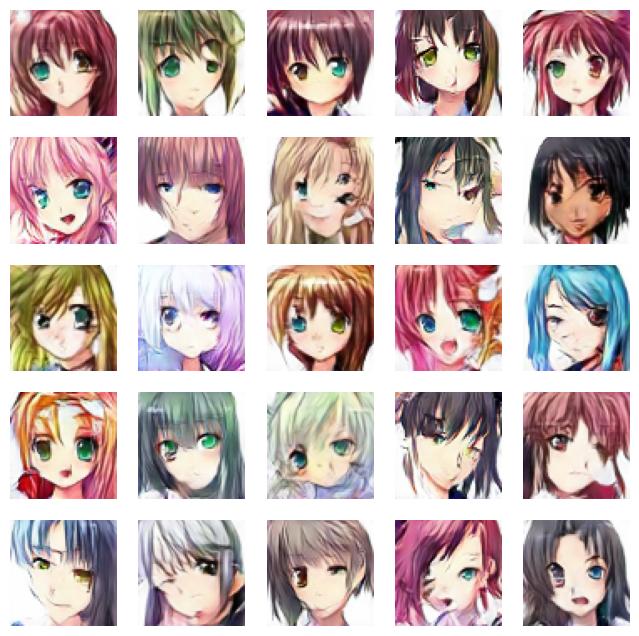

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.6523 - g_loss: 0.8872
Epoch 15/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6433 - g_loss: 0.9151

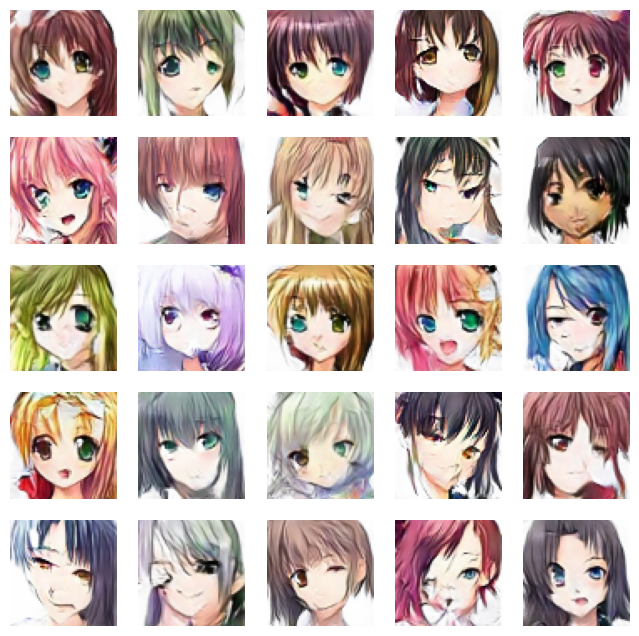

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.6433 - g_loss: 0.9151
Epoch 16/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6398 - g_loss: 0.9385

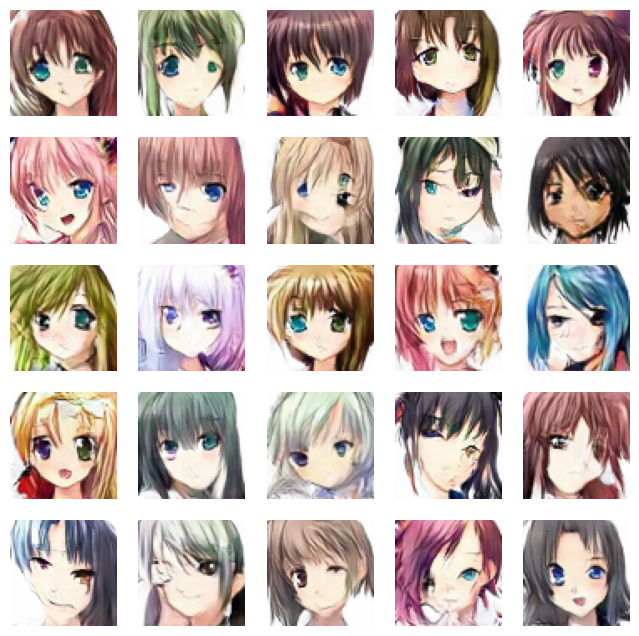

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 78s 29ms/step - d_loss: 0.6398 - g_loss: 0.9385
Epoch 17/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.6343 - g_loss: 0.9633

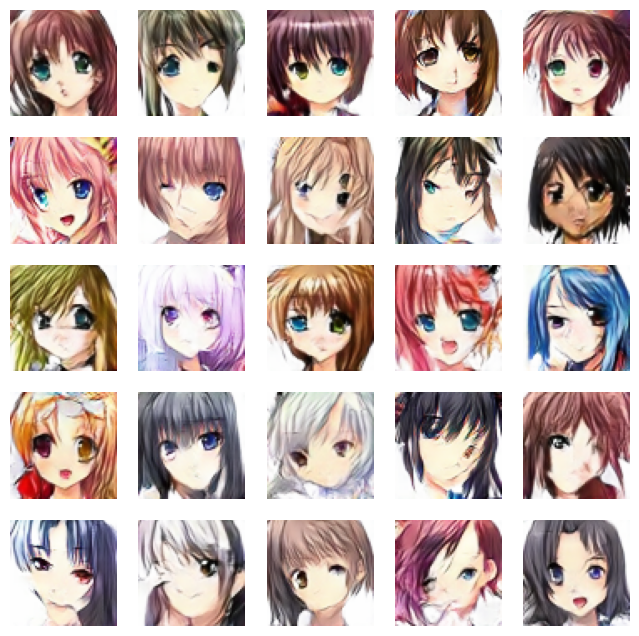

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 76s 29ms/step - d_loss: 0.6343 - g_loss: 0.9633
Epoch 18/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.6257 - g_loss: 0.9854

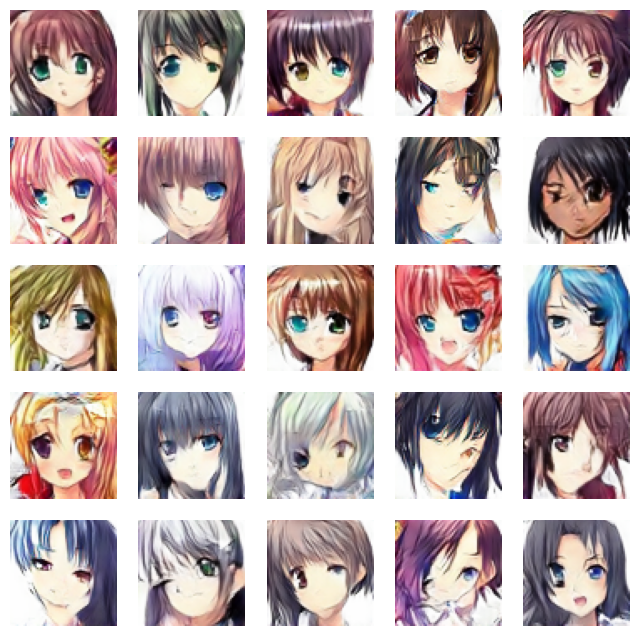

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.6257 - g_loss: 0.9854
Epoch 19/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.6198 - g_loss: 1.0136

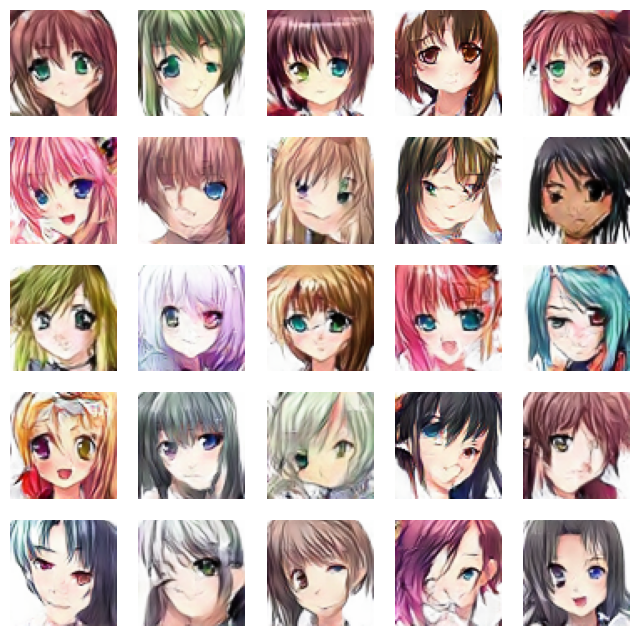

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.6198 - g_loss: 1.0136
Epoch 20/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.6134 - g_loss: 1.0405

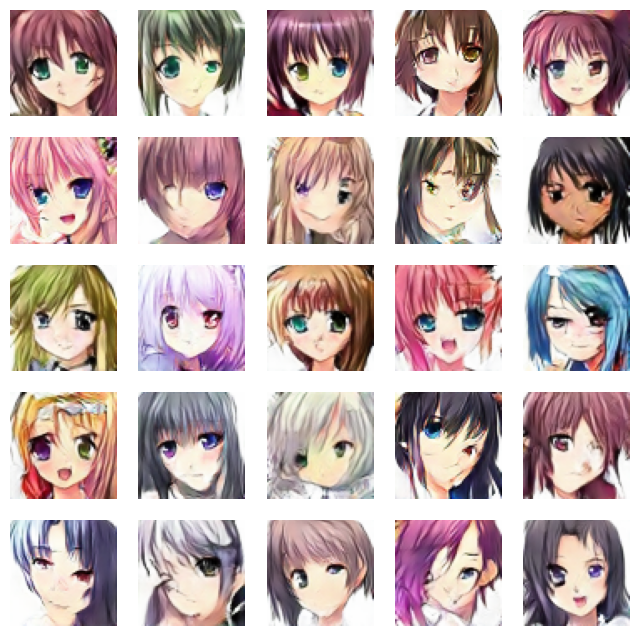

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.6134 - g_loss: 1.0405
Epoch 21/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6072 - g_loss: 1.0668

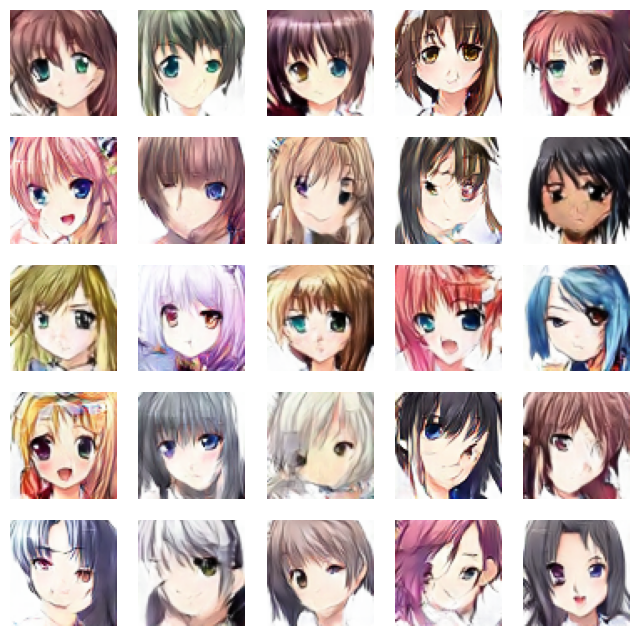

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.6072 - g_loss: 1.0668
Epoch 22/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.6008 - g_loss: 1.0950

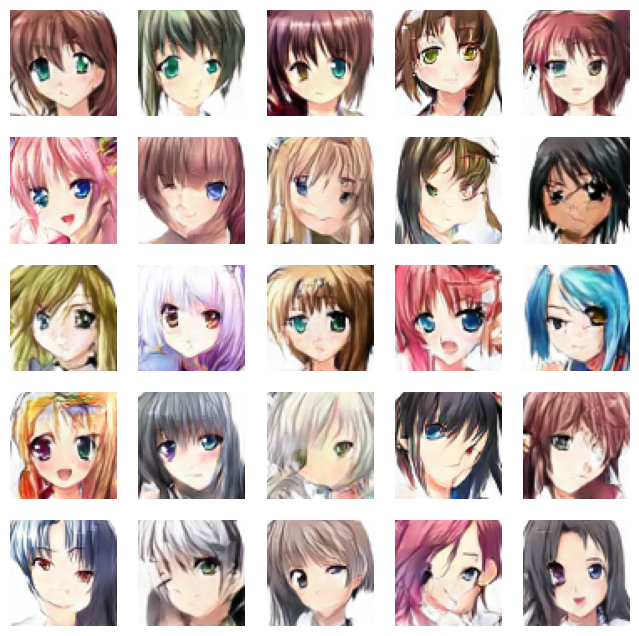

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.6008 - g_loss: 1.0950
Epoch 23/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.5911 - g_loss: 1.1271

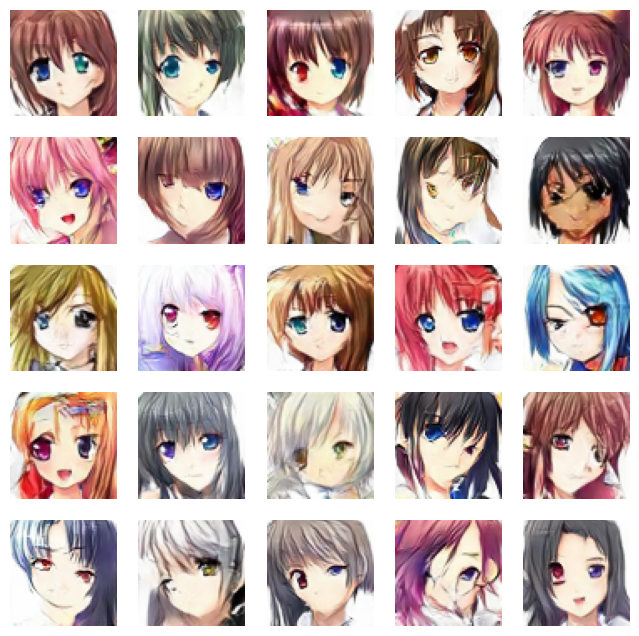

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.5911 - g_loss: 1.1271
Epoch 24/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.5870 - g_loss: 1.1518

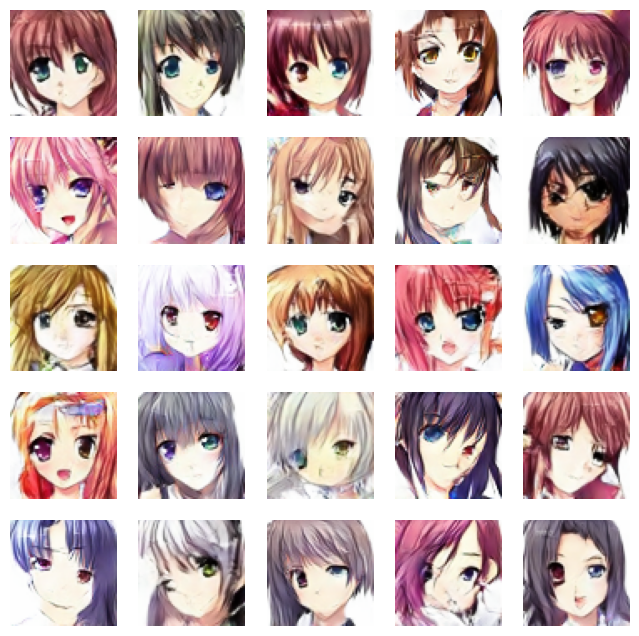

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.5870 - g_loss: 1.1518
Epoch 25/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.5803 - g_loss: 1.1762

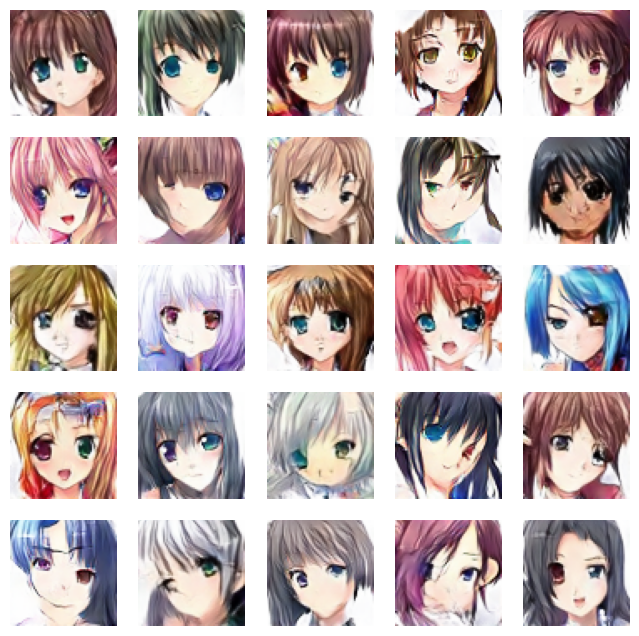

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.5803 - g_loss: 1.1762
Epoch 26/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.5750 - g_loss: 1.2024

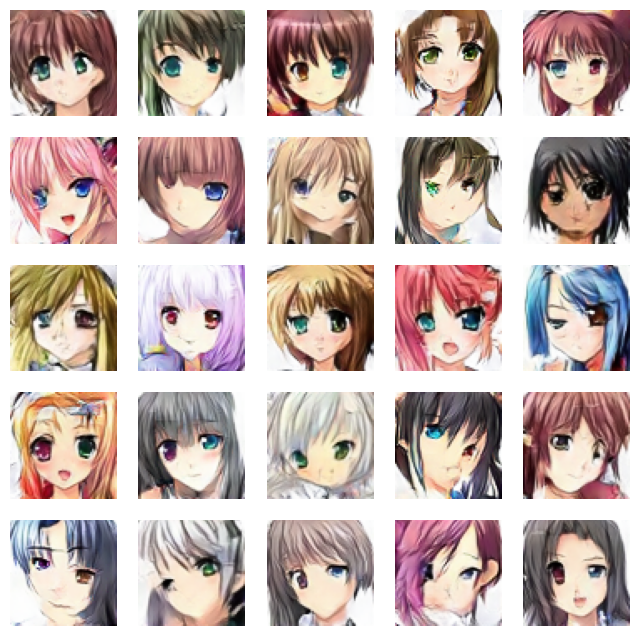

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 78s 29ms/step - d_loss: 0.5751 - g_loss: 1.2024
Epoch 27/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.5729 - g_loss: 1.2286

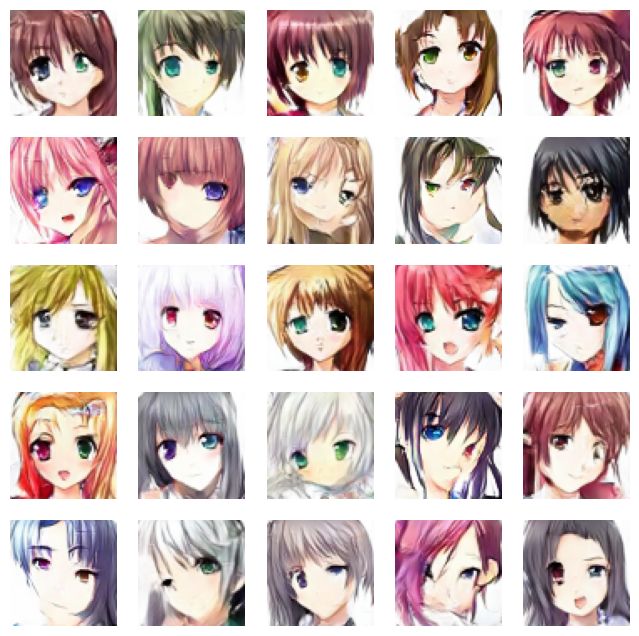

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.5729 - g_loss: 1.2286
Epoch 28/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.5652 - g_loss: 1.2519

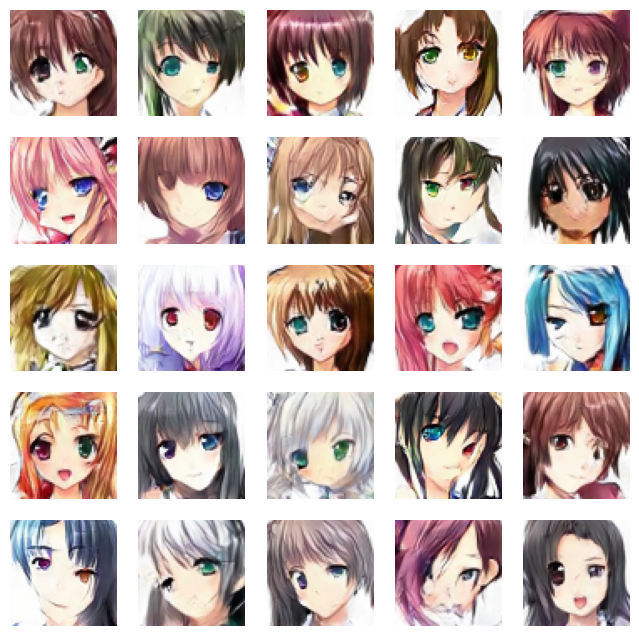

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.5652 - g_loss: 1.2519
Epoch 29/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.5645 - g_loss: 1.2778

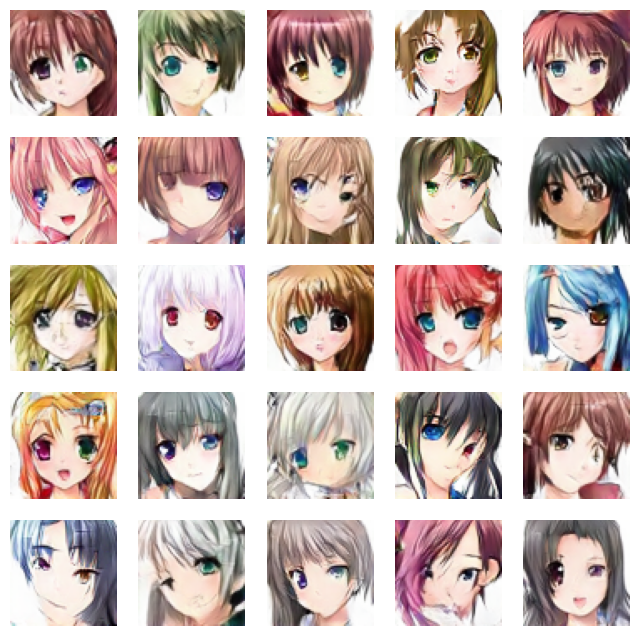

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.5645 - g_loss: 1.2778
Epoch 30/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.5554 - g_loss: 1.3036

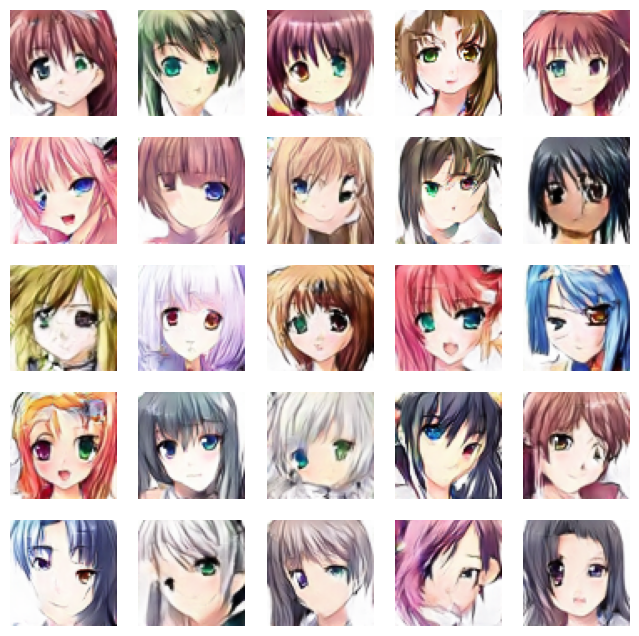

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.5554 - g_loss: 1.3036
Epoch 31/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.5475 - g_loss: 1.3306

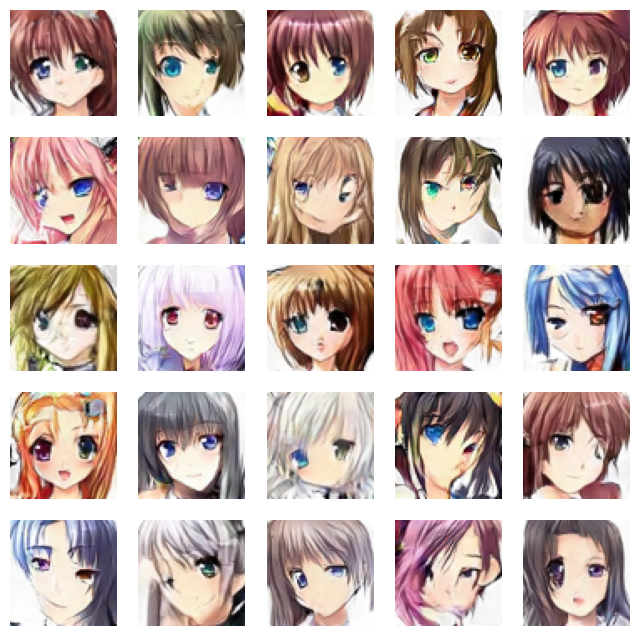

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.5475 - g_loss: 1.3306
Epoch 32/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.5419 - g_loss: 1.3512

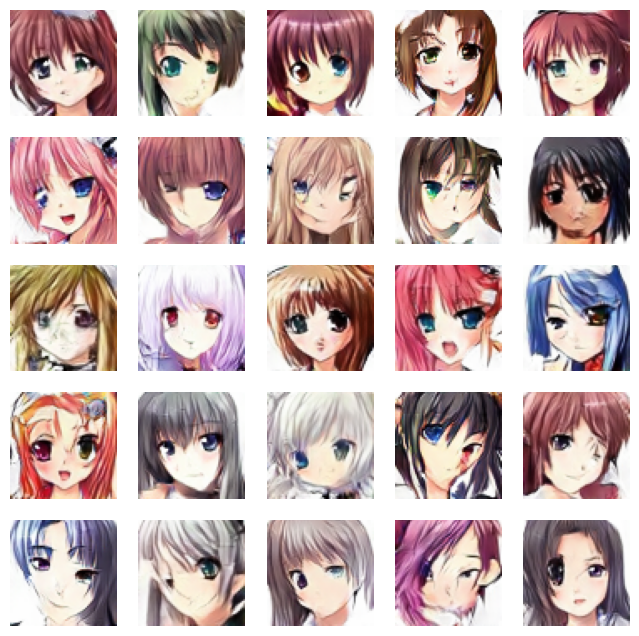

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.5419 - g_loss: 1.3512
Epoch 33/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.5383 - g_loss: 1.3820

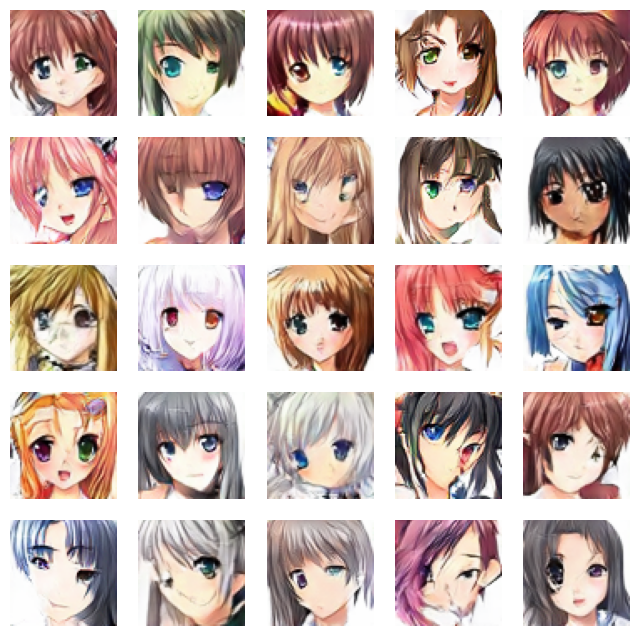

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 78s 29ms/step - d_loss: 0.5383 - g_loss: 1.3820
Epoch 34/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.5360 - g_loss: 1.4031

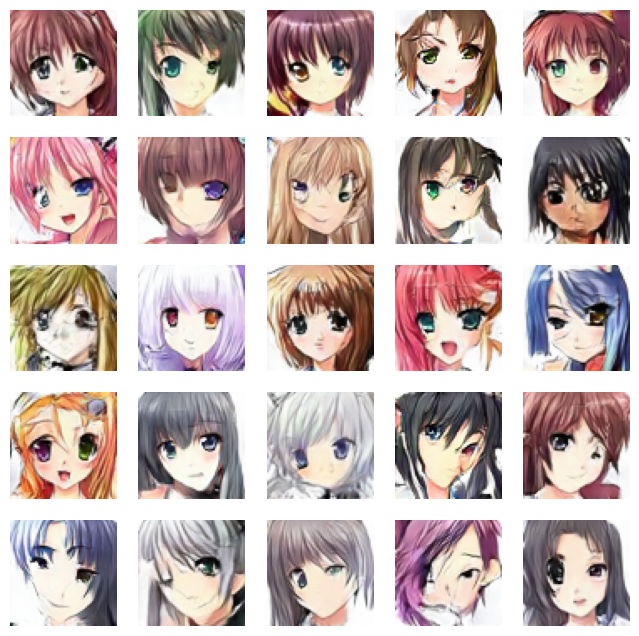

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.5360 - g_loss: 1.4031
Epoch 35/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.5306 - g_loss: 1.4347

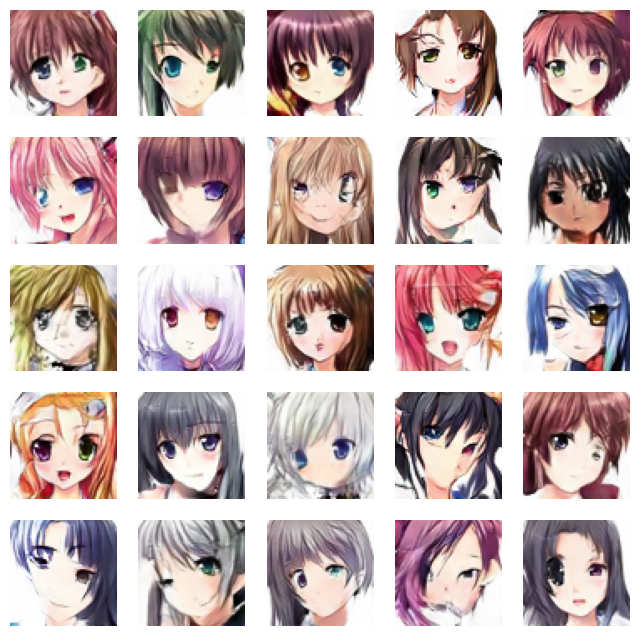

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.5306 - g_loss: 1.4347
Epoch 36/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.5275 - g_loss: 1.4504

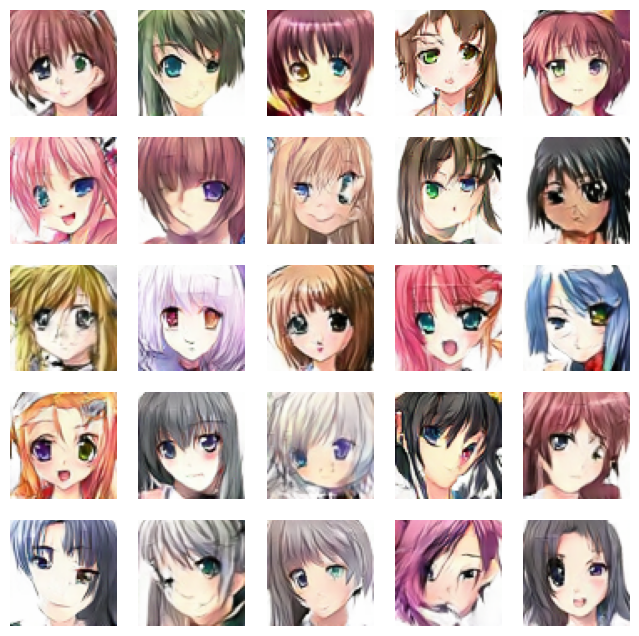

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.5275 - g_loss: 1.4504
Epoch 37/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.5208 - g_loss: 1.4664

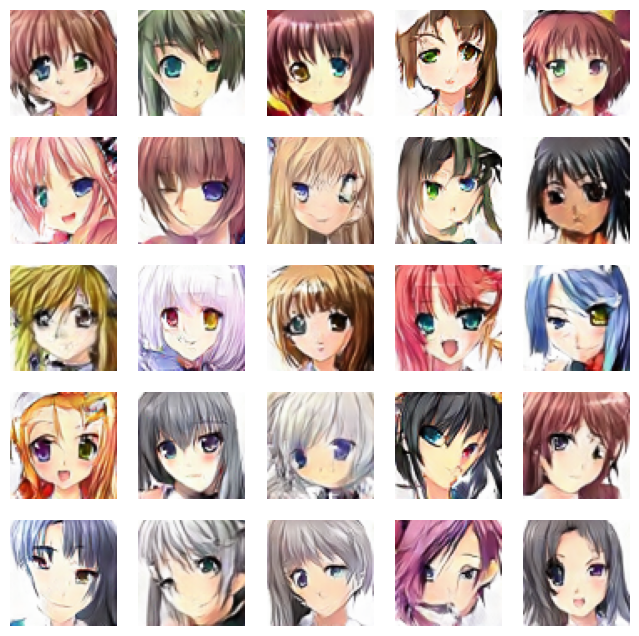

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.5208 - g_loss: 1.4664
Epoch 38/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.5193 - g_loss: 1.4888

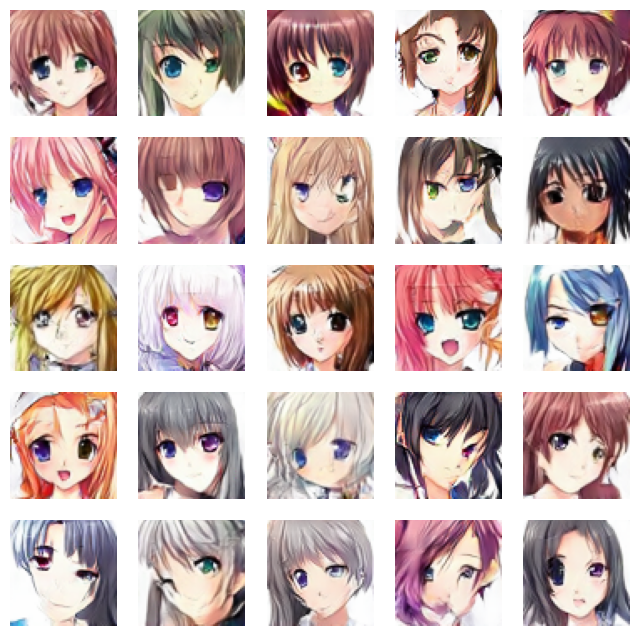

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.5193 - g_loss: 1.4888
Epoch 39/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.5146 - g_loss: 1.5098

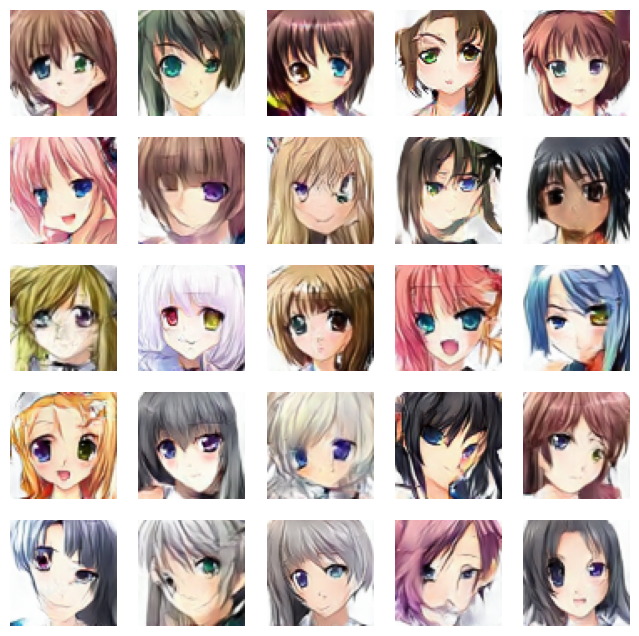

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.5146 - g_loss: 1.5099
Epoch 40/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.5137 - g_loss: 1.5233

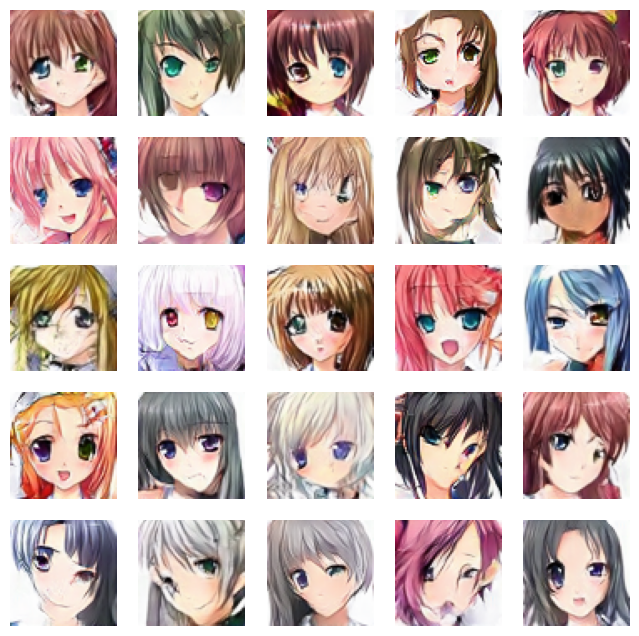

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.5137 - g_loss: 1.5233
Epoch 41/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.5076 - g_loss: 1.5475

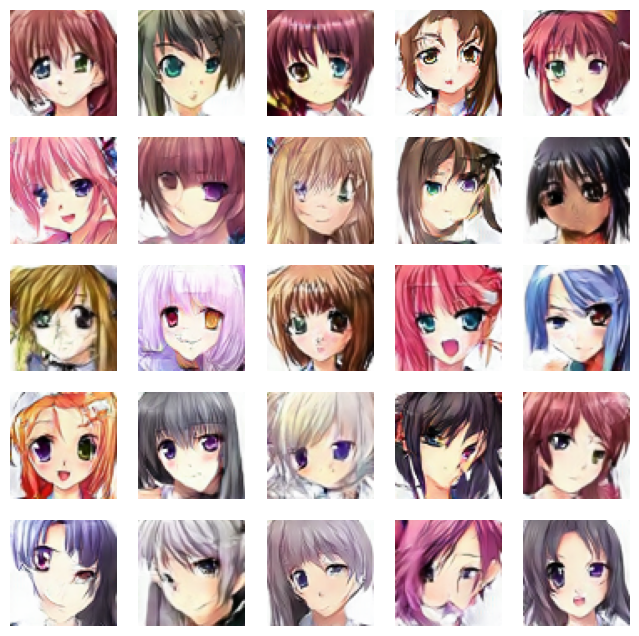

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.5076 - g_loss: 1.5475
Epoch 42/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.5032 - g_loss: 1.5740

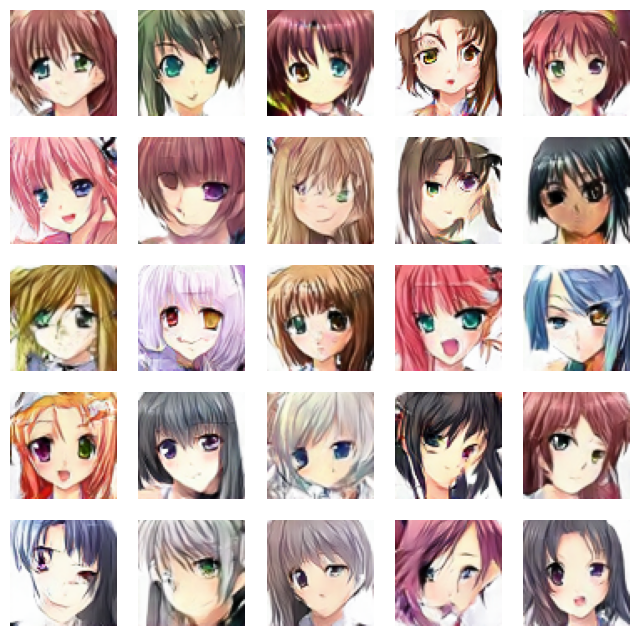

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.5032 - g_loss: 1.5740
Epoch 43/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.4998 - g_loss: 1.5962

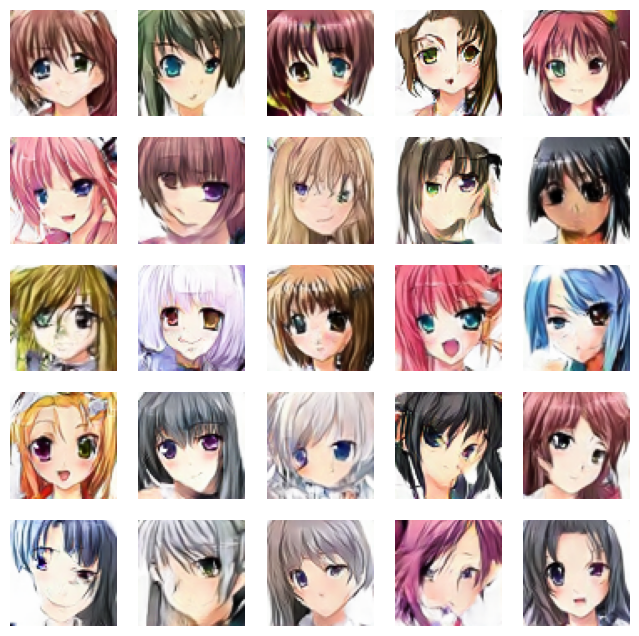

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.4998 - g_loss: 1.5962
Epoch 44/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.4911 - g_loss: 1.6116

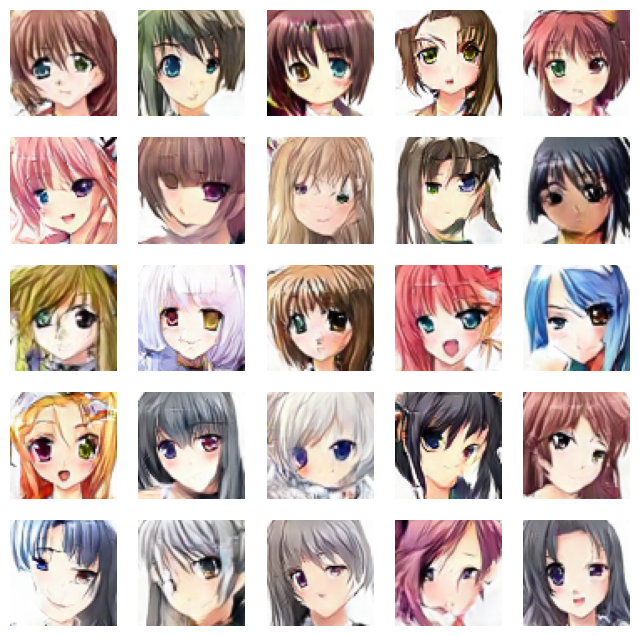

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.4911 - g_loss: 1.6116
Epoch 45/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.4916 - g_loss: 1.6262

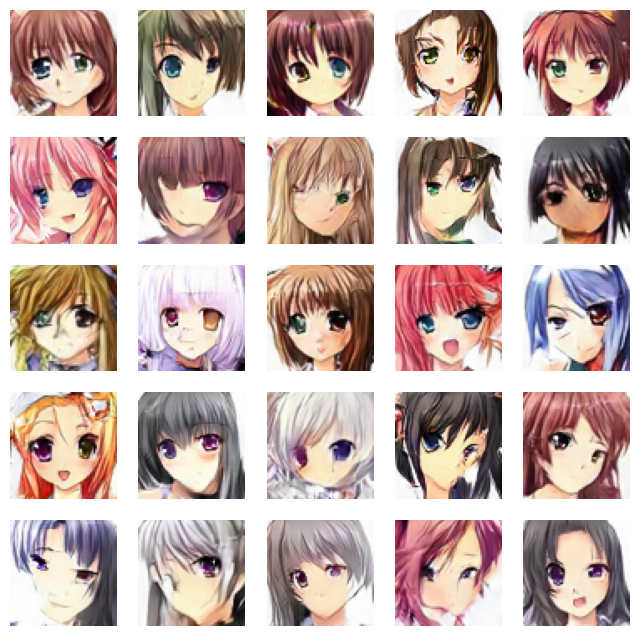

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.4916 - g_loss: 1.6262
Epoch 46/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.4905 - g_loss: 1.6551

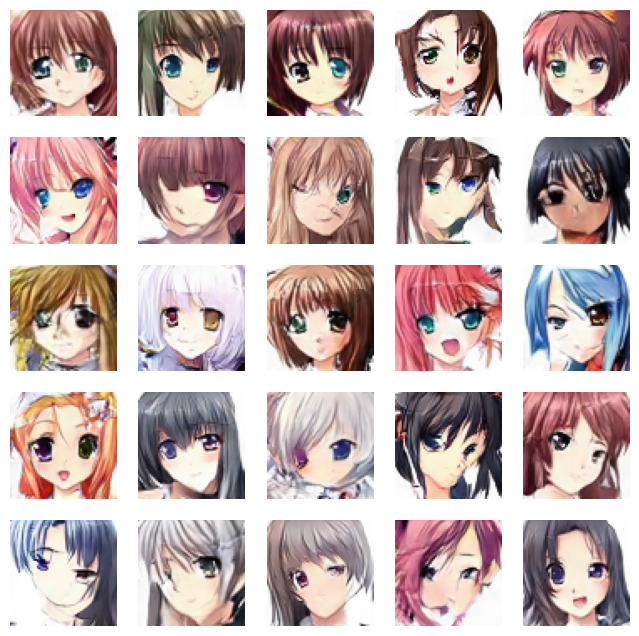

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.4905 - g_loss: 1.6551
Epoch 47/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.4849 - g_loss: 1.6678

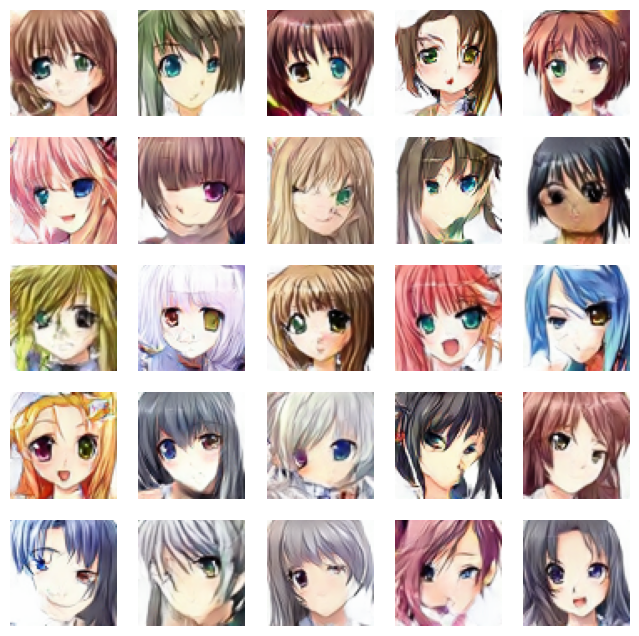

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.4849 - g_loss: 1.6678
Epoch 48/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.4842 - g_loss: 1.6930

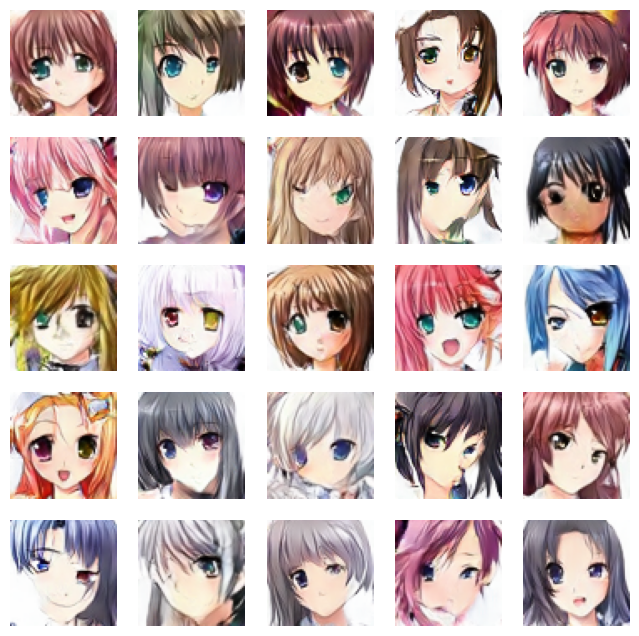

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.4842 - g_loss: 1.6930
Epoch 49/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.4803 - g_loss: 1.7044

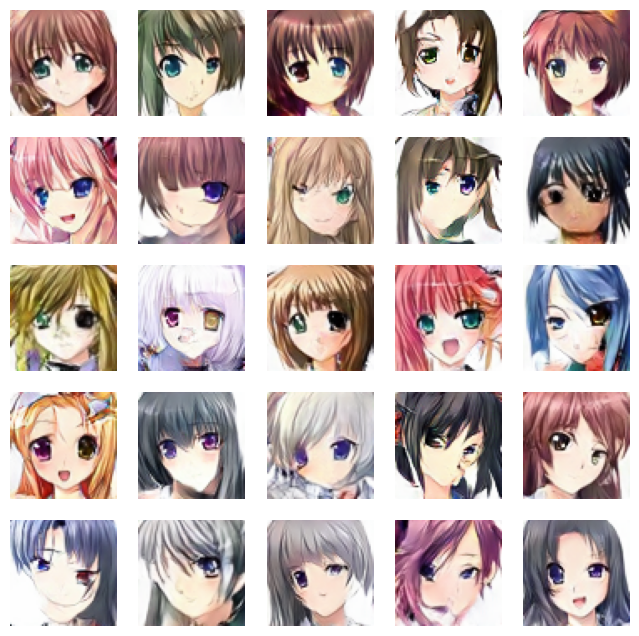

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.4803 - g_loss: 1.7044
Epoch 50/50
2659/2660 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.4726 - g_loss: 1.7132

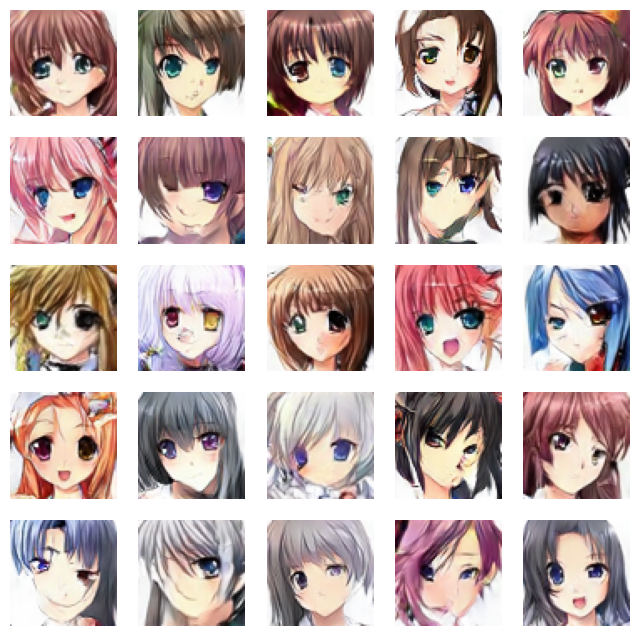

2660/2660 ━━━━━━━━━━━━━━━━━━━━ 77s 29ms/step - d_loss: 0.4726 - g_loss: 1.7132


In [27]:
EPOCHS = 50
dcgan.fit(X_train, epochs=EPOCHS, callbacks=[DCGANMonitor()])

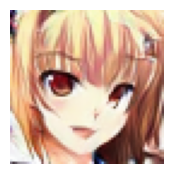

In [97]:
# Reshape noise to match the expected shape (1, 100)
noise = tf.random.normal(shape=(2, 100))

# Generate the image from noise
g_img = dcgan.generator(noise)

# Denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
plt.figure(figsize=(2,2))
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
plt.show()